In [1]:
# Basic Libraries
import numpy as np
import pandas as pd
import seaborn as sb
import matplotlib.pyplot as plt # we only need pyplot
sb.set() # set the default Seaborn style for graphics

In [ ]:
annual_combined_data = pd.read_excel("Yearly Data.xlsx", usecols=lambda x: 'Unnamed' not in x)
combined_changed_data_together_overall = pd.read_excel("Yearly Change Data.xlsx", usecols=lambda x: 'Unnamed' not in x)
combined_changed_data_together_overall_percent = pd.read_excel("Yearly % Change Data.xlsx", usecols=lambda x: 'Unnamed' not in x)

In [ ]:
annual_live_birth = annual_combined_data.iloc[:, :2]
annual_live_birth

In [ ]:
live_birth_annual_change = pd.DataFrame(columns=["Year_Month", "Change in Live Birth"])
for i in range(1, annual_live_birth.shape[0]):
    if ((annual_live_birth.iloc[i, 1] - annual_live_birth.iloc[i-1, 1]) > 0):
        change = "INCREASE"
    else:
        change = "DECREASE"
    live_birth_annual_change.loc[i] = [annual_live_birth.iloc[i, 0], change]   
live_birth_annual_change

## XGBoost Default Parameters (Raw Data)

In [ ]:
from numpy import loadtxt
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from xgboost import plot_tree
from matplotlib.pylab import rcParams

Average over 1000 tries, Accuracy: 61.52%


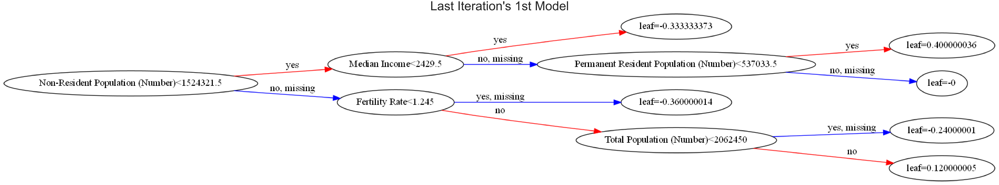

In [67]:
annual_combined_data_temp = annual_combined_data.iloc[1:,:].copy()
annual_combined_data_temp.insert(1, live_birth_annual_change.columns[1], live_birth_annual_change.iloc[:, 1])

temp_X = annual_combined_data_temp.copy()

temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)

# Extract Response and Predictors
y = annual_combined_data_temp["Change in Live Birth"]
X = pd.DataFrame(temp_X.drop(columns=["Year", "number of live_birth in the year", 'Change in Live Birth'], axis = 1))

all_accuracy = []

for i in range(1000):
    # Split the Dataset into Train and Test
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

    from sklearn.preprocessing import LabelEncoder
    le = LabelEncoder()
    y_train = le.fit_transform(y_train)

    # fit model no training data
    model = XGBClassifier()
    model.fit(X_train, y_train)

    # make predictions for test data
    y_test = le.fit_transform(y_test)

    y_pred = model.predict(X_test)
    predictions = [round(value) for value in y_pred]

    # evaluate predictions
    accuracy = accuracy_score(y_test, predictions)
    all_accuracy.append(accuracy)
    
print("Average over 1000 tries, Accuracy: %.2f%%" % (sum(all_accuracy)/1000 * 100.0))

# set up the parameters
rcParams['figure.figsize'] = 100,75
plot_tree(model, rankdir="LR")
plt.title("Last Iteration's 1st Model", fontsize = 70)
plt.show()

## XGBoost Default Parameters (Change Data)

Average over 1000 tries, Accuracy: 89.34%


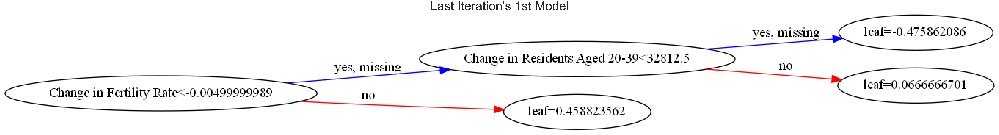

In [68]:
temp_X = combined_changed_data_together_overall.copy()

temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)

# Extract Response and Predictors
y = annual_combined_data_temp["Change in Live Birth"]
X = pd.DataFrame(temp_X.drop(columns=["Year", "Change in Live Birth", 'Change in Live Birth Number'], axis = 1))

all_accuracy = []

for i in range(1000):
    # Split the Dataset into Train and Test
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

    from sklearn.preprocessing import LabelEncoder
    le = LabelEncoder()
    y_train = le.fit_transform(y_train)

    # fit model no training data
    model = XGBClassifier()
    model.fit(X_train, y_train)

    # make predictions for test data
    y_test = le.fit_transform(y_test)

    y_pred = model.predict(X_test)
    predictions = [round(value) for value in y_pred]

    # evaluate predictions
    accuracy = accuracy_score(y_test, predictions)
    all_accuracy.append(accuracy)
    
print("Average over 1000 tries, Accuracy: %.2f%%" % (sum(all_accuracy)/1000 * 100.0))

# set up the parameters
rcParams['figure.figsize'] = 100,75
plot_tree(model, rankdir="LR")
plt.title("Last Iteration's 1st Model", fontsize = 70)
plt.show()

## XGBoost Default Parameters (% Change Data)

Average over 1000 tries, Accuracy: 88.48%


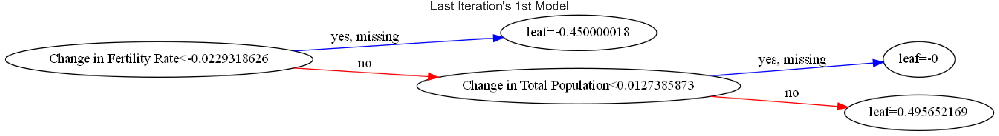

In [69]:
temp_X = combined_changed_data_together_overall_percent.copy()

temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)

# Extract Response and Predictors
y = annual_combined_data_temp["Change in Live Birth"]
X = pd.DataFrame(temp_X.drop(columns=["Year", "Change in Live Birth", 'Change in Live Birth Number'], axis = 1))

all_accuracy = []

for i in range(1000):
    # Split the Dataset into Train and Test
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

    from sklearn.preprocessing import LabelEncoder
    le = LabelEncoder()
    y_train = le.fit_transform(y_train)

    # fit model no training data
    model = XGBClassifier()
    model.fit(X_train, y_train)

    # make predictions for test data
    y_test = le.fit_transform(y_test)

    y_pred = model.predict(X_test)
    predictions = [round(value) for value in y_pred]

    # evaluate predictions
    accuracy = accuracy_score(y_test, predictions)
    all_accuracy.append(accuracy)
    
print("Average over 1000 tries, Accuracy: %.2f%%" % (sum(all_accuracy)/1000 * 100.0))

# set up the parameters
rcParams['figure.figsize'] = 100,75
plot_tree(model, rankdir="LR")
plt.title("Last Iteration's 1st Model", fontsize = 70)
plt.show()

## XGBoost Tuned Hyperparameters (Raw Data)

Average over 1000 tries, Accuracy: 63.16%


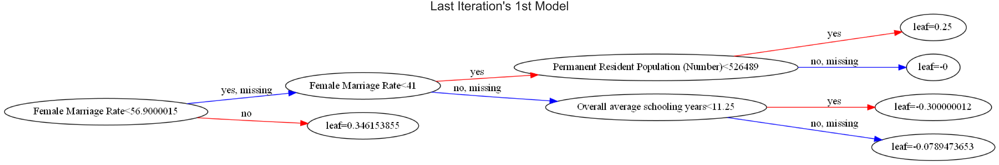

In [91]:
annual_combined_data_temp = annual_combined_data.iloc[1:,:].copy()
annual_combined_data_temp.insert(1, live_birth_annual_change.columns[1], live_birth_annual_change.iloc[:, 1])

temp_X = annual_combined_data_temp.copy()

temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)

# Extract Response and Predictors
y = annual_combined_data_temp["Change in Live Birth"]
X = pd.DataFrame(temp_X.drop(columns=["Year", "number of live_birth in the year", 'Change in Live Birth'], axis = 1))

all_accuracy = []

for i in range(1000):
    # Split the Dataset into Train and Test
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

    from sklearn.preprocessing import LabelEncoder
    le = LabelEncoder()
    y_train = le.fit_transform(y_train)

    # fit model no training data
    model = XGBClassifier(max_depth=3,gamma=0.2,eta=0.25)
    model.fit(X_train, y_train)

    # make predictions for test data
    y_test = le.fit_transform(y_test)

    y_pred = model.predict(X_test)
    predictions = [round(value) for value in y_pred]

    # evaluate predictions
    accuracy = accuracy_score(y_test, predictions)
    all_accuracy.append(accuracy)
print("Average over 1000 tries, Accuracy: %.2f%%" % (sum(all_accuracy)/1000 * 100.0))

# set up the parameters
rcParams['figure.figsize'] = 100,75
plot_tree(model, rankdir="LR")
plt.title("Last Iteration's 1st Model", fontsize = 70)
plt.show()

## XGBoost Tuned Hyperparameters (Change Data)

Average over 1000 tries, Accuracy: 92.11%


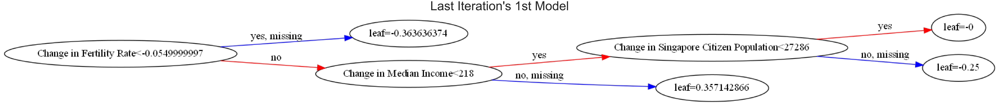

In [93]:
temp_X = combined_changed_data_together_overall.copy()

temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)

# Extract Response and Predictors
y = annual_combined_data_temp["Change in Live Birth"]
X = pd.DataFrame(temp_X.drop(columns=["Year", "Change in Live Birth", 'Change in Live Birth Number'], axis = 1))

all_accuracy = []

for i in range(1000):
    # Split the Dataset into Train and Test
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

    from sklearn.preprocessing import LabelEncoder
    le = LabelEncoder()
    y_train = le.fit_transform(y_train)

    # fit model no training data
    model = XGBClassifier(max_depth=3,gamma=0.2,eta=0.25)
    model.fit(X_train, y_train)

    # make predictions for test data
    y_test = le.fit_transform(y_test)

    y_pred = model.predict(X_test)
    predictions = [round(value) for value in y_pred]

    # evaluate predictions
    accuracy = accuracy_score(y_test, predictions)
    all_accuracy.append(accuracy)
    
print("Average over 1000 tries, Accuracy: %.2f%%" % (sum(all_accuracy)/1000 * 100.0))

# set up the parameters
rcParams['figure.figsize'] = 100,75
plot_tree(model, rankdir="LR")
plt.title("Last Iteration's 1st Model", fontsize = 70)
plt.show()

## XGBoost Tuned Hyperparameters (% Change Data)

Average over 1000 tries, Accuracy: 89.12%


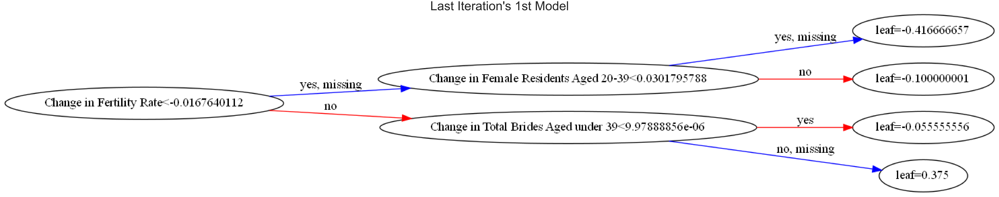

In [89]:
temp_X = combined_changed_data_together_overall_percent.copy()

temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)

# Extract Response and Predictors
y = annual_combined_data_temp["Change in Live Birth"]
X = pd.DataFrame(temp_X.drop(columns=["Year", "Change in Live Birth", 'Change in Live Birth Number'], axis = 1))

all_accuracy = []

for i in range(1000):
    # Split the Dataset into Train and Test
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

    from sklearn.preprocessing import LabelEncoder
    le = LabelEncoder()
    y_train = le.fit_transform(y_train)

    # fit model no training data
    model = XGBClassifier(max_depth=3,gamma=0.2,eta=0.25)
    model.fit(X_train, y_train)

    # make predictions for test data
    y_test = le.fit_transform(y_test)

    y_pred = model.predict(X_test)
    predictions = [round(value) for value in y_pred]

    # evaluate predictions
    accuracy = accuracy_score(y_test, predictions)
    all_accuracy.append(accuracy)
    
print("Average over 1000 tries, Accuracy: %.2f%%" % (sum(all_accuracy)/1000 * 100.0))

# set up the parameters
rcParams['figure.figsize'] = 100,75
plot_tree(model, rankdir="LR")
plt.title("Last Iteration's 1st Model", fontsize = 70)
plt.show()

## XGBoost GridSearchCV (Raw Data)

In [74]:
annual_combined_data_temp = annual_combined_data.iloc[1:,:].copy()
annual_combined_data_temp.insert(1, live_birth_annual_change.columns[1], live_birth_annual_change.iloc[:, 1])

temp_X = annual_combined_data_temp.copy()

temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)

# Extract Response and Predictors
y = annual_combined_data_temp["Change in Live Birth"]
X = pd.DataFrame(temp_X.drop(columns=["Year", "number of live_birth in the year", 'Change in Live Birth'], axis = 1))

# Split the Dataset into Train and Test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
y_train = le.fit_transform(y_train)

from sklearn.model_selection import GridSearchCV

param = {'max_depth': [3,5,6,9, None], 
         'n_estimators':[50, 70, 100, 150, 200],
         'eta':[0.1,0.15,0.2,0.25,0.3],
         'gamma':[0.1,0.2,0.3,0.4]}

grid_model = GridSearchCV(XGBClassifier(), param_grid=param, cv=3)

grid_model.fit(X_train,y_train)
print(grid_model.best_score_)
print(grid_model.best_params_)

0.6984126984126985
{'eta': 0.1, 'gamma': 0.1, 'max_depth': 3, 'n_estimators': 50}


## XGBoost GridSearchCV (Change Data)

In [78]:
temp_X = combined_changed_data_together_overall.copy()
temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)

# Extract Response and Predictors
y = combined_changed_data_together_overall_percent['Change in Live Birth']
X = pd.DataFrame(temp_X.drop(columns=["Year", "Change in Live Birth", 'Change in Live Birth Number'], axis = 1))

# Split the Dataset into Train and Test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
y_train = le.fit_transform(y_train)

from sklearn.model_selection import GridSearchCV

param = {'max_depth': [3,5,6,9, None], 
         'n_estimators':[50, 70, 100, 150, 200],
         'eta':[0.1,0.15,0.2,0.25,0.3],
         'gamma':[0.1,0.2,0.3,0.4]}

grid_model = GridSearchCV(XGBClassifier(), param_grid=param, cv=3)

grid_model.fit(X_train,y_train)
print(grid_model.best_score_)
print(grid_model.best_params_)

0.9777777777777779
{'eta': 0.1, 'gamma': 0.1, 'max_depth': 3, 'n_estimators': 70}


## XGBoost GridSearchCV (% Change Data)

In [83]:
temp_X = combined_changed_data_together_overall_percent.copy()
temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)

# Extract Response and Predictors
y = combined_changed_data_together_overall_percent['Change in Live Birth']
X = pd.DataFrame(temp_X.drop(columns=["Year", "Change in Live Birth", 'Change in Live Birth Number'], axis = 1))

# Split the Dataset into Train and Test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
y_train = le.fit_transform(y_train)

from sklearn.model_selection import GridSearchCV

param = {'max_depth': [3,5,6,9, None], 
         'n_estimators':[50, 70, 100, 150, 200], 
         'eta':[0.1,0.15,0.2,0.25,0.3],
         'gamma':[0.1,0.2,0.3,0.4]}

grid_model = GridSearchCV(XGBClassifier(), param_grid=param, cv=3)

grid_model.fit(X_train,y_train)
print(grid_model.best_score_)
print(grid_model.best_params_)

0.9285714285714285
{'eta': 0.25, 'gamma': 0.3, 'max_depth': 3, 'n_estimators': 50}


## SHAP and LIME Feature Evaluation

Accuracy: 94.74%


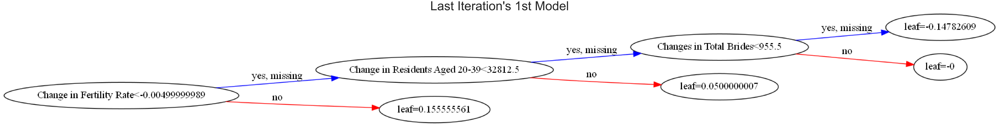

data row 1
Intercept 0.42930851633391454
Prediction_local [0.65260496]
Right: 0.81494397


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


,Feature,Contribution
0,Change in Fertility Rate,0.339461
1,Change in Female Residents Aged 20-39,0.047549
2,Changes in Total Brides,0.022358
3,Change in Residents Aged 20-39,0.013914
4,Change in Permanent Resident Population,0.007290
5,Change in Total Brides Aged under 44,-0.005732
6,Change in Total Residents,-0.004602
7,Change in People with Minimum Education,-0.002916
8,Change in Unemployment Rate,0.001939
9,Change in Resident Population,0.001915






data row 3
Intercept 0.4333872442375344
Prediction_local [0.50687709]
Right: 0.14354354


,Feature,Contribution
0,Change in Fertility Rate,0.349217
1,Change in Female Residents Aged 20-39,0.044210
2,Changes in Total Brides,0.020914
3,Change in Residents Aged 20-39,0.015738
4,Change in Total Brides Aged under 39,0.007241
5,Change in Resident Population,0.006008
6,Change in Average Full-Time Working Hours per ...,-0.004787
7,Change in Permanent Resident Population,-0.004625
8,Change in Non-Resident Population,0.002797
9,Change in Males' Average Schooling Years,0.002203






data row 5
Intercept 0.4340540657146827
Prediction_local [0.34316559]
Right: 0.20007229


,Feature,Contribution
0,Change in Fertility Rate,0.346251
1,Change in Female Residents Aged 20-39,0.047878
2,Changes in Total Brides,0.022483
3,Change in Residents Aged 20-39,0.015476
4,Change in Average Full-Time Working Hours per ...,-0.009899
5,Change in Total Brides Aged under 39,0.006297
6,Change in Old-Age Support Ratio of Citizens Ag...,-0.005171
7,Change in Males' Average Schooling Years,-0.003797
8,Change in Females' Average Schooling Years,-0.002736
9,Change in Unemployment Rate,-0.001371






data row 8
Intercept 0.4166292251939553
Prediction_local [0.94534889]
Right: 0.9488006


,Feature,Contribution
0,Change in Fertility Rate,0.118559
1,Changes in Total Brides,0.016431
2,Change in Singapore Citizen Population,-0.015694
3,Change in Resident Population,-0.013569
4,Change in Total Population,-0.013550
5,Change in Non-Resident Population,-0.010592
6,Change in Total Residents,-0.010013
7,Change in Total Brides Aged under 39,0.009763
8,Change in Female Residents Aged 20-39,0.009145
9,Change in Female Marriage Rate,0.006525






data row 15
Intercept 0.4341619557190841
Prediction_local [0.14300492]
Right: 0.030060675


,Feature,Contribution
0,Change in Fertility Rate,0.335878
1,Change in Female Residents Aged 20-39,0.055284
2,Changes in Total Brides,0.017543
3,Change in Residents Aged 20-39,0.013007
4,Change in Total Residents,-0.010982
5,Change in Singapore Citizen Population,0.009643
6,Change in People with Minimum Education,-0.008280
7,Change in Non-Resident Population,0.006963
8,Change in Average Full-Time Working Hours per ...,-0.006028
9,Change in Resident Population,0.004961


Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.


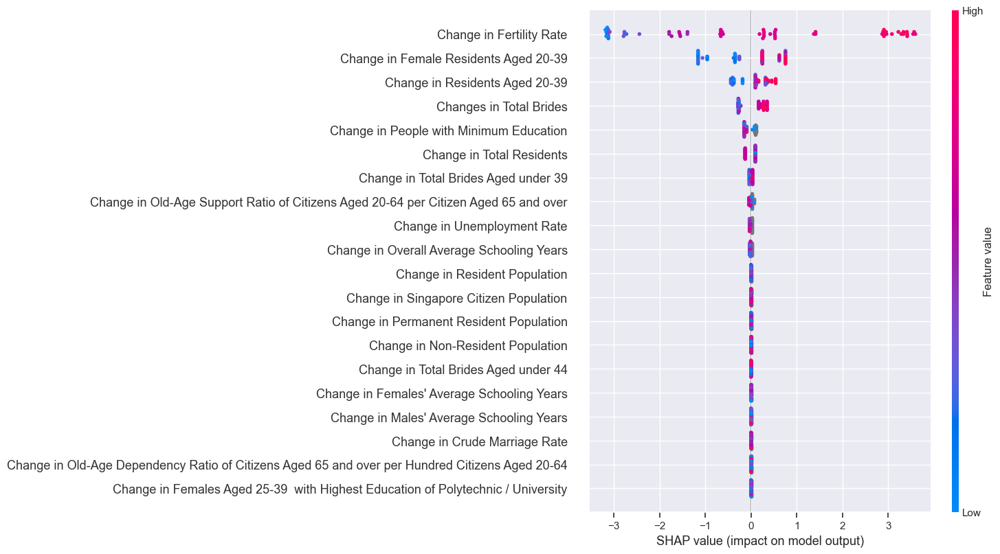

In [102]:
temp_X = combined_changed_data_together_overall.copy()

temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)

# Extract Response and Predictors
y = combined_changed_data_together_overall['Change in Live Birth']
X = pd.DataFrame(temp_X.drop(columns=["Year", "Change in Live Birth", 'Change in Live Birth Number'], axis = 1))

# Split the Dataset into Train and Test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
y_train = le.fit_transform(y_train)
import numpy as np

# fit model no training data
model = XGBClassifier(max_depth=3, gamma=0.1, eta=0.1, n_estimators=70)
model.fit(X_train, y_train)

# make predictions for test data
y_test = le.fit_transform(y_test)

y_pred = model.predict(X_test)
predictions = [round(value) for value in y_pred]

# evaluate predictions
accuracy = accuracy_score(y_test, predictions)
print("Accuracy: %.2f%%" % (accuracy * 100.0))

##set up the parameters
rcParams['figure.figsize'] = 100,75
plot_tree(model, rankdir="LR")
plt.title("Last Iteration's 1st Model", fontsize = 70)
plt.show()

import lime 
from lime import lime_tabular

import shap
shap.initjs()

shap_explainer = shap.TreeExplainer(model)
shap_values = shap_explainer.shap_values(X)

test_1 = X_test.iloc[3]

lime_explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train.values[:,:],
    feature_names = X_train.columns,
    class_names=['DECREASE','INCREASE'],
    discretize_continuous=False,
    verbose=True)
i = 0
j = 0
while (i != 5):
    if (X_test.iloc[j].isnull().values.any()):
        j += 1
        continue
    print(f"data row {j+1}")
    lime_exp = lime_explainer.explain_instance(
        data_row=X_test.iloc[j,:],
        predict_fn=model.predict_proba
    )
    lime_exp.show_in_notebook(show_table=True)
    display(pd.DataFrame(lime_exp.as_list(),columns=['Feature','Contribution']))
    print()
    print()
    display(shap.force_plot(shap_explainer.expected_value, shap_values[1, :], X_test.iloc[0,:]))
    print()
    print()
    print()
    print()
    i += 1
    j += 1
shap.summary_plot(shap_values, X)

Accuracy: 94.74%


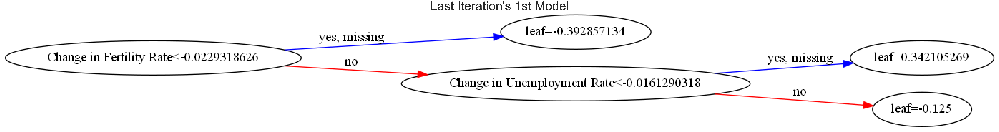

data row 7
Intercept 0.2984967144959934
Prediction_local [0.21435705]
Right: 0.08163024


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


,Feature,Contribution
0,Change in Fertility Rate,0.280389
1,Change in Female Residents Aged 20-39,0.031735
2,Change in Unemployment Rate,-0.026408
3,Change in Total Residents,-0.021831
4,Change in Non-Resident Population,0.016829
5,Change in Residents Aged 20-39,0.010312
6,Change in Total Population,0.009495
7,Change in Resident Population,-0.006021
8,Change in Overall Average Schooling Years,-0.005169
9,Change in Permanent Resident Population,0.002029






data row 8
Intercept 0.2991981800006697
Prediction_local [0.40470568]
Right: 0.29931223


,Feature,Contribution
0,Change in Fertility Rate,0.293770
1,Change in Female Residents Aged 20-39,0.024707
2,Change in Unemployment Rate,-0.019822
3,Change in Total Residents,-0.015451
4,Change in Non-Resident Population,0.015369
5,Change in Residents Aged 20-39,0.009822
6,Change in Total Population,0.008866
7,Changes in Total Brides,-0.005843
8,Change in Males' Average Schooling Years,-0.005711
9,Change in Old-Age Dependency Ratio of Citizens...,0.004832






data row 14
Intercept 0.2957456226081849
Prediction_local [0.29225203]
Right: 0.04333178


,Feature,Contribution
0,Change in Fertility Rate,0.289262
1,Change in Female Residents Aged 20-39,0.023721
2,Change in Total Residents,-0.021137
3,Change in Non-Resident Population,0.015690
4,Change in Residents Aged 20-39,0.007759
5,Change in Old-Age Support Ratio of Citizens Ag...,0.005678
6,Change in Resident Population,-0.005460
7,Change in Old-Age Dependency Ratio of Citizens...,0.003888
8,Change in Females Aged 25-39 with Highest Edu...,0.002738
9,Change in Total Population,0.002201






data row 16
Intercept 0.30325309195307104
Prediction_local [0.87045728]
Right: 0.9107725


,Feature,Contribution
0,Change in Fertility Rate,0.306473
1,Change in Unemployment Rate,-0.028482
2,Change in Female Residents Aged 20-39,0.019598
3,Change in Total Residents,-0.018692
4,Change in Non-Resident Population,0.013475
5,Change in Crude Marriage Rate,-0.007960
6,Change in Resident Population,-0.005209
7,Change in Residents Aged 20-39,0.005104
8,Change in Old-Age Dependency Ratio of Citizens...,0.004223
9,Change in Permanent Resident Population,0.004019






data row 18
Intercept 0.29401149740638666
Prediction_local [0.04233969]
Right: 0.032621443


,Feature,Contribution
0,Change in Fertility Rate,0.280653
1,Change in Female Residents Aged 20-39,0.023448
2,Change in Total Residents,-0.018136
3,Change in Residents Aged 20-39,0.012468
4,Change in Non-Resident Population,0.009237
5,Change in Total Population,0.005246
6,Change in Average Full-Time Working Hours per ...,0.004142
7,Change in Old-Age Dependency Ratio of Citizens...,0.003751
8,Change in Singapore Citizen Population,-0.003313
9,Change in Resident Population,-0.003107


Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.


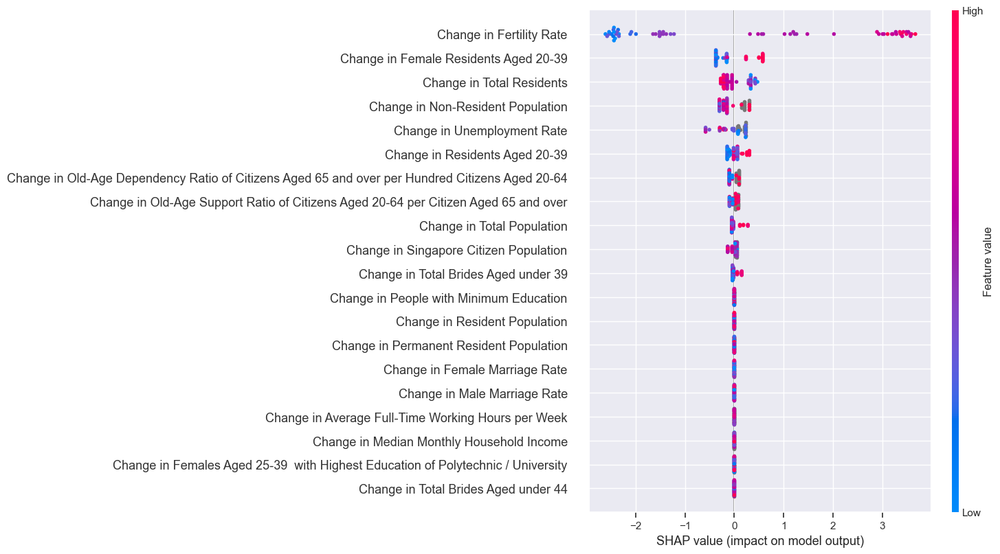

In [139]:
temp_X = combined_changed_data_together_overall_percent.copy()

temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)

# Extract Response and Predictors
y = combined_changed_data_together_overall['Change in Live Birth']
X = pd.DataFrame(temp_X.drop(columns=["Year", "Change in Live Birth", 'Change in Live Birth Number'], axis = 1))


# Split the Dataset into Train and Test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
y_train = le.fit_transform(y_train)
import numpy as np


# fit model no training data
model = XGBClassifier(max_depth=3, gamma=0.3, eta=0.25, n_estimators=50)
model.fit(X_train, y_train)

# make predictions for test data
y_test = le.fit_transform(y_test)

y_pred = model.predict(X_test)
predictions = [round(value) for value in y_pred]

# evaluate predictions
accuracy = accuracy_score(y_test, predictions)
print("Accuracy: %.2f%%" % (accuracy * 100.0))

##set up the parameters
rcParams['figure.figsize'] = 100,75
plot_tree(model, rankdir="LR")
plt.title("Last Iteration's 1st Model", fontsize = 70)
plt.show()

import lime 
from lime import lime_tabular

import shap
shap.initjs()

shap_explainer = shap.TreeExplainer(model)
shap_values = shap_explainer.shap_values(X)

test_1 = X_test.iloc[3]

lime_explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train.values[:,:],
    feature_names = X_train.columns,
    class_names=['DECREASE','INCREASE'],
    discretize_continuous=False,
    verbose=True)
i = 0
j = 0
while (i != 5):
    if (X_test.iloc[j].isnull().values.any()):
        j += 1
        continue
    print(f"data row {j+1}")
    lime_exp = lime_explainer.explain_instance(
        data_row=X_test.iloc[j,:],
        predict_fn=model.predict_proba
    )
    lime_exp.show_in_notebook(show_table=True)
    display(pd.DataFrame(lime_exp.as_list(),columns=['Feature','Contribution']))
    print()
    print()
    display(shap.force_plot(shap_explainer.expected_value, shap_values[1, :], X_test.iloc[0,:]))
    print()
    print()
    print()
    print()
    i += 1
    j += 1
shap.summary_plot(shap_values, X)

## SHAP and LIME Feature Evaluation without Fertility Rate

### In our analysis, we calculated the SHAP values for each feature and visualized them using summary plots. The initial summary plot revealed that the fertility rate had a significant impact on the model for the annual datasets. Which is useful for predicting the change in the number of live births.

### However, as it is merely a symptom of the fertility rate. The model was not useful in identifying the causes of the change in birth numbers.

### As a result, we removed factors that could be a symptom of the birth number such as fertility rate and infant death from the model and ran it again. 

Accuracy: 84.21%


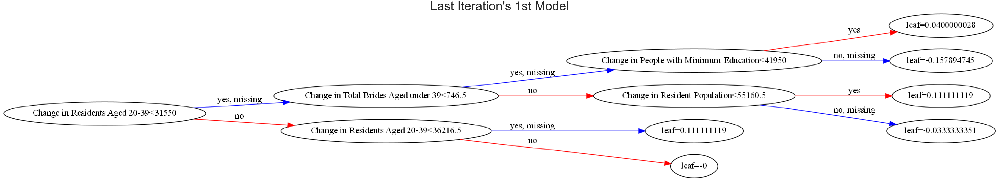

data row 2
Intercept 0.46696181386416236
Prediction_local [0.8677316]
Right: 0.946082


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


,Feature,Contribution
0,Change in People with Minimum Education,-0.149040
1,Changes in Total Brides,0.095721
2,Change in Total Residents,-0.047444
3,Change in Total Brides Aged under 39,0.044574
4,Change in Residents Aged 20-39,0.038922
5,Change in Total Population,0.037048
6,Change in Female Residents Aged 20-39,0.035546
7,Change in Average Full-Time Working Hours per ...,-0.027159
8,Change in Resident Population,-0.023743
9,Change in Male Marriage Rate,0.015777






data row 4
Intercept 0.46125309500302475
Prediction_local [0.12081185]
Right: 0.15949543


,Feature,Contribution
0,Change in People with Minimum Education,-0.154690
1,Changes in Total Brides,0.090141
2,Change in Total Residents,-0.047793
3,Change in Total Brides Aged under 39,0.038105
4,Change in Residents Aged 20-39,0.037893
5,Change in Female Residents Aged 20-39,0.032671
6,Change in Total Population,0.032047
7,Change in Male Marriage Rate,0.016331
8,Change in Resident Population,-0.015006
9,Change in Old-Age Dependency Ratio of Citizens...,0.006242






data row 7
Intercept 0.47391519141180866
Prediction_local [0.40625327]
Right: 0.4911002


,Feature,Contribution
0,Change in People with Minimum Education,-0.145940
1,Changes in Total Brides,0.088696
2,Change in Residents Aged 20-39,0.048100
3,Change in Total Residents,-0.045064
4,Change in Total Brides Aged under 39,0.044011
5,Change in Total Population,0.032340
6,Change in Average Full-Time Working Hours per ...,-0.030009
7,Change in Female Residents Aged 20-39,0.028759
8,Change in Resident Population,-0.026657
9,Change in Non-Resident Population,0.013371






data row 9
Intercept 0.46683176682353605
Prediction_local [1.01379828]
Right: 0.8267102


,Feature,Contribution
0,Change in People with Minimum Education,-0.161129
1,Changes in Total Brides,0.078785
2,Change in Residents Aged 20-39,0.041478
3,Change in Total Residents,-0.039671
4,Change in Total Population,0.038523
5,Change in Female Residents Aged 20-39,0.032688
6,Change in Resident Population,-0.024290
7,Change in Average Full-Time Working Hours per ...,-0.023885
8,Change in Non-Resident Population,0.009178
9,Change in Median Monthly Household Income,0.003179






data row 11
Intercept 0.49444266447835505
Prediction_local [0.89925292]
Right: 0.89945984


,Feature,Contribution
0,Change in People with Minimum Education,-0.071218
1,Changes in Total Brides,0.056603
2,Change in Total Residents,-0.035640
3,Change in Total Brides Aged under 39,0.030157
4,Change in Total Population,0.017056
5,Change in Female Residents Aged 20-39,0.016869
6,Change in Residents Aged 20-39,0.016005
7,Change in Resident Population,-0.010810
8,Change in Non-Resident Population,0.005508
9,Change in Permanent Resident Population,0.001485


Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.


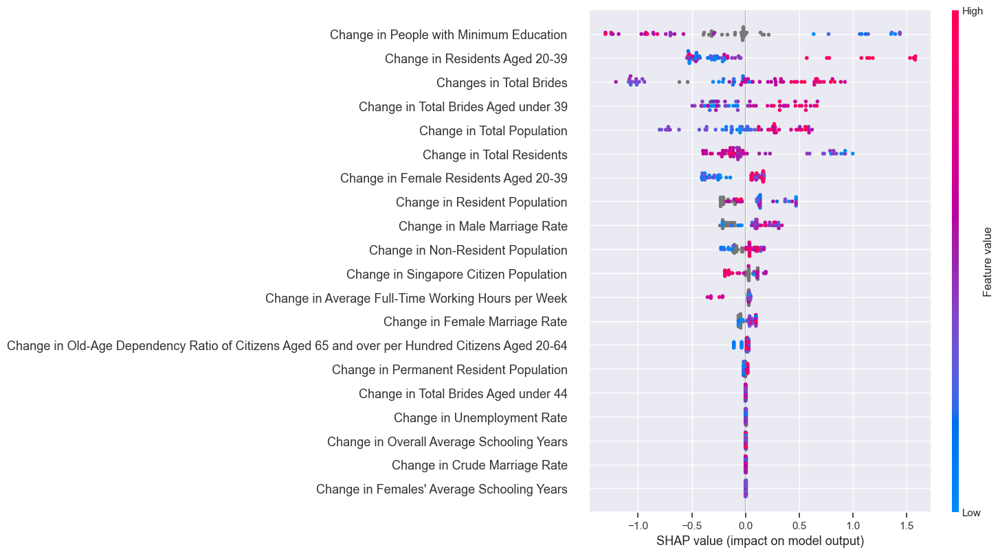

In [132]:
temp_X = combined_changed_data_together_overall.copy()
#temp_X.fillna(temp_X.mean(), inplace=True)
#temp_X

temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)

# Extract Response and Predictors
y = combined_changed_data_together_overall['Change in Live Birth']
X = pd.DataFrame(temp_X.drop(columns=["Year", "Change in Live Birth", 'Change in Live Birth Number', 'Change in Fertility Rate'], axis = 1))

#X.fillna(X.mean, inplace=True)
#print(X)

# Split the Dataset into Train and Test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
#print(y_train)
y_train = le.fit_transform(y_train)
import numpy as np
##print(type(y_train))


# fit model no training data
model = XGBClassifier(max_depth=3, gamma=0.1, eta=0.1, n_estimators=70)
model.fit(X_train, y_train)

# make predictions for test data
y_test = le.fit_transform(y_test)

y_pred = model.predict(X_test)
predictions = [round(value) for value in y_pred]

# evaluate predictions
accuracy = accuracy_score(y_test, predictions)
print("Accuracy: %.2f%%" % (accuracy * 100.0))

##set up the parameters
rcParams['figure.figsize'] = 100,75
plot_tree(model, rankdir="LR")
plt.title("Last Iteration's 1st Model", fontsize = 70)
plt.show()

import lime 
from lime import lime_tabular

import shap
shap.initjs()

shap_explainer = shap.TreeExplainer(model)
shap_values = shap_explainer.shap_values(X)

test_1 = X_test.iloc[3]

lime_explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train.values[:,:],
    feature_names = X_train.columns,
    class_names=['DECREASE','INCREASE'],
    discretize_continuous=False,
    verbose=True)
i = 0
j = 0
while (i != 5):
    if (X_test.iloc[j].isnull().values.any()):
        j += 1
        continue
    print(f"data row {j+1}")
    lime_exp = lime_explainer.explain_instance(
        data_row=X_test.iloc[j,:],
        predict_fn=model.predict_proba
    )
    lime_exp.show_in_notebook(show_table=True)
    display(pd.DataFrame(lime_exp.as_list(),columns=['Feature','Contribution']))
    print()
    print()
    display(shap.force_plot(shap_explainer.expected_value, shap_values[1, :], X_test.iloc[0,:]))
    print()
    print()
    print()
    print()
    i += 1
    j += 1
shap.summary_plot(shap_values, X)

Accuracy: 78.95%


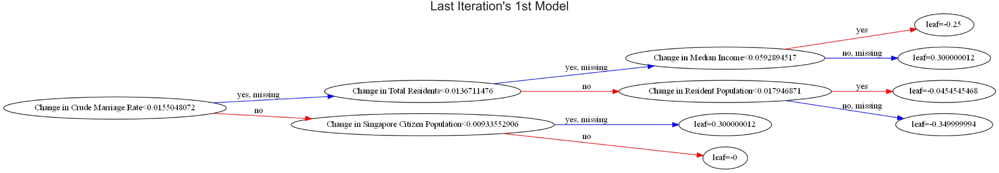

data row 1
Intercept 0.3720955343737476
Prediction_local [0.68465992]
Right: 0.8882972


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


,Feature,Contribution
0,Change in Crude Marriage Rate,0.089430
1,Change in Singapore Citizen Population,-0.088326
2,Change in Unemployment Rate,-0.071043
3,Change in People with Minimum Education,-0.065814
4,Change in Total Residents,-0.042474
5,Changes in Total Brides,0.030742
6,Change in Total Brides Aged under 39,-0.028622
7,Change in Median Income,0.025965
8,Change in Female Marriage Rate,0.018036
9,Change in Female Residents Aged 20-39,0.015084






data row 2
Intercept 0.3740427244554847
Prediction_local [0.38669236]
Right: 0.13079375


,Feature,Contribution
0,Change in Crude Marriage Rate,0.087422
1,Change in Singapore Citizen Population,-0.081940
2,Change in Unemployment Rate,-0.073150
3,Change in People with Minimum Education,-0.065065
4,Change in Total Residents,-0.041950
5,Changes in Total Brides,0.030719
6,Change in Total Brides Aged under 39,-0.018754
7,Change in Female Residents Aged 20-39,0.016652
8,Change in Residents Aged 20-39,0.013324
9,Change in Old-Age Dependency Ratio of Citizens...,0.006367






data row 5
Intercept 0.37210177148343765
Prediction_local [0.42346066]
Right: 0.24335787


,Feature,Contribution
0,Change in Crude Marriage Rate,0.091019
1,Change in Unemployment Rate,-0.074173
2,Change in People with Minimum Education,-0.063102
3,Change in Total Residents,-0.046076
4,Changes in Total Brides,0.029512
5,Change in Female Marriage Rate,0.024853
6,Change in Non-Resident Population,0.016208
7,Change in Total Brides Aged under 39,-0.015777
8,Change in Female Residents Aged 20-39,0.013655
9,Change in Residents Aged 20-39,0.011367






data row 11
Intercept 0.36837301906785413
Prediction_local [0.21677357]
Right: 0.15006675


,Feature,Contribution
0,Change in Crude Marriage Rate,0.085230
1,Change in Singapore Citizen Population,-0.080251
2,Change in Unemployment Rate,-0.067154
3,Change in People with Minimum Education,-0.061703
4,Change in Total Residents,-0.040145
5,Changes in Total Brides,0.033741
6,Change in Female Marriage Rate,0.025010
7,Change in Residents Aged 20-39,0.018508
8,Change in Total Brides Aged under 39,-0.016560
9,Change in Female Residents Aged 20-39,0.015169






data row 12
Intercept 0.37163698183517185
Prediction_local [0.32693359]
Right: 0.42768157


,Feature,Contribution
0,Change in Crude Marriage Rate,0.090955
1,Change in Singapore Citizen Population,-0.086314
2,Change in Unemployment Rate,-0.068364
3,Change in People with Minimum Education,-0.061488
4,Change in Total Residents,-0.041543
5,Changes in Total Brides,0.026762
6,Change in Female Marriage Rate,0.025474
7,Change in Total Brides Aged under 39,-0.021798
8,Change in Female Residents Aged 20-39,0.013689
9,Change in Old-Age Dependency Ratio of Citizens...,0.006655


Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.


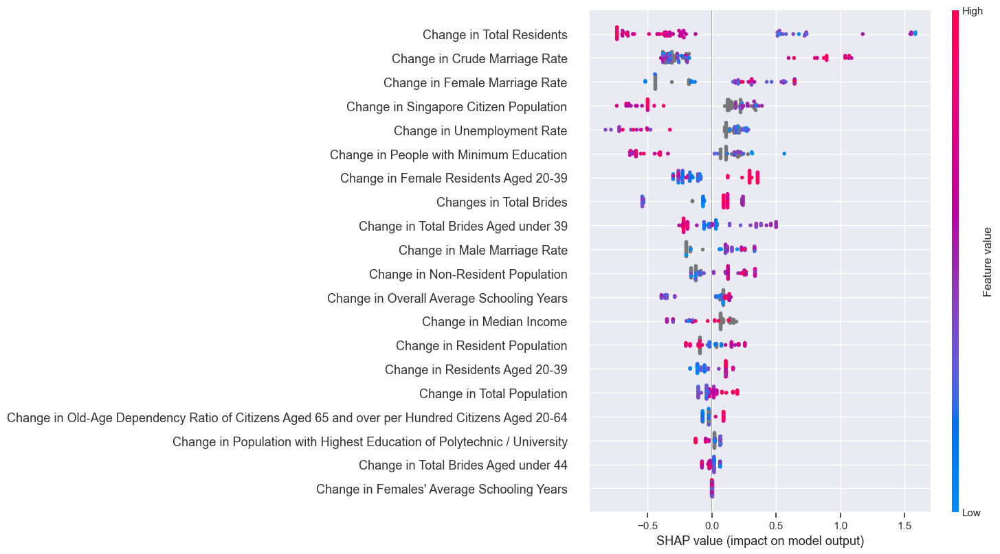

In [146]:
temp_X = combined_changed_data_together_overall_percent.copy()
#temp_X.fillna(temp_X.mean(), inplace=True)
#temp_X

temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)

# Extract Response and Predictors
y = combined_changed_data_together_overall['Change in Live Birth']
X = pd.DataFrame(temp_X.drop(columns=["Year", "Change in Live Birth", 'Change in Live Birth Number', 'Change in Fertility Rate'], axis = 1))

#X.fillna(X.mean, inplace=True)
#print(X)

# Split the Dataset into Train and Test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
#print(y_train)
y_train = le.fit_transform(y_train)
import numpy as np
##print(type(y_train))


# fit model no training data
model = XGBClassifier(max_depth=3, gamma=0.3, eta=0.25, n_estimators=50)
model.fit(X_train, y_train)

# make predictions for test data
y_test = le.fit_transform(y_test)

y_pred = model.predict(X_test)
predictions = [round(value) for value in y_pred]

# evaluate predictions
accuracy = accuracy_score(y_test, predictions)
print("Accuracy: %.2f%%" % (accuracy * 100.0))

##set up the parameters
rcParams['figure.figsize'] = 100,75
plot_tree(model, rankdir="LR")
plt.title("Last Iteration's 1st Model", fontsize = 70)
plt.show()

import lime 
from lime import lime_tabular

import shap
shap.initjs()

shap_explainer = shap.TreeExplainer(model)
shap_values = shap_explainer.shap_values(X)

test_1 = X_test.iloc[3]

lime_explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train.values[:,:],
    feature_names = X_train.columns,
    class_names=['DECREASE','INCREASE'],
    discretize_continuous=False,
    verbose=True)
i = 0
j = 0
while (i != 5):
    if (X_test.iloc[j].isnull().values.any()):
        j += 1
        continue
    print(f"data row {j+1}")
    lime_exp = lime_explainer.explain_instance(
        data_row=X_test.iloc[j,:],
        predict_fn=model.predict_proba
    )
    lime_exp.show_in_notebook(show_table=True)
    display(pd.DataFrame(lime_exp.as_list(),columns=['Feature','Contribution']))
    print()
    print()
    display(shap.force_plot(shap_explainer.expected_value, shap_values[1, :], X_test.iloc[0,:]))
    print()
    print()
    print()
    print()
    i += 1
    j += 1
shap.summary_plot(shap_values, X)